In [1]:
import numpy as np

from libsvm.svmutil import *

import matplotlib.pylab as plt
import numpy as np

import networkx as nx
import dwave_networkx as dnx
import matplotlib.pyplot as plt
import dimod
import collections
import math
import pickle
from dwave.system import DWaveSampler, EmbeddingComposite, FixedEmbeddingComposite
from dwave.cloud import Client
from dwave.system import DWaveSampler
from dwave.embedding import EmbeddedStructure
from dwave import inspector
import dwave.embedding
from dimod.binary import BinaryQuadraticModel
from minorminer import find_embedding

import torch.nn as nn
import torch.nn.functional as F
from torch.autograd import Function


from qubovert import *
from qubovert.sim import anneal_pubo, anneal_qubo

import gurobipy as grb

import time


np.random.seed(2)
inspector.enable_data_capture()

Leap_API_token =  "" ### from the leap account dashboard at https://cloud.dwavesys.com/
DATA = './datos'

In [2]:
client = Client.from_config(token=Leap_API_token)

solvers = client.get_solvers(num_qubits__gt=3000)
solvers

solver = solvers[-1]
solver

G = nx.Graph()
G.add_edges_from( solver.edges )
print(solver.id)

Advantage_system6.4


In [3]:
G = dnx.pegasus_graph(20, create_using=G)

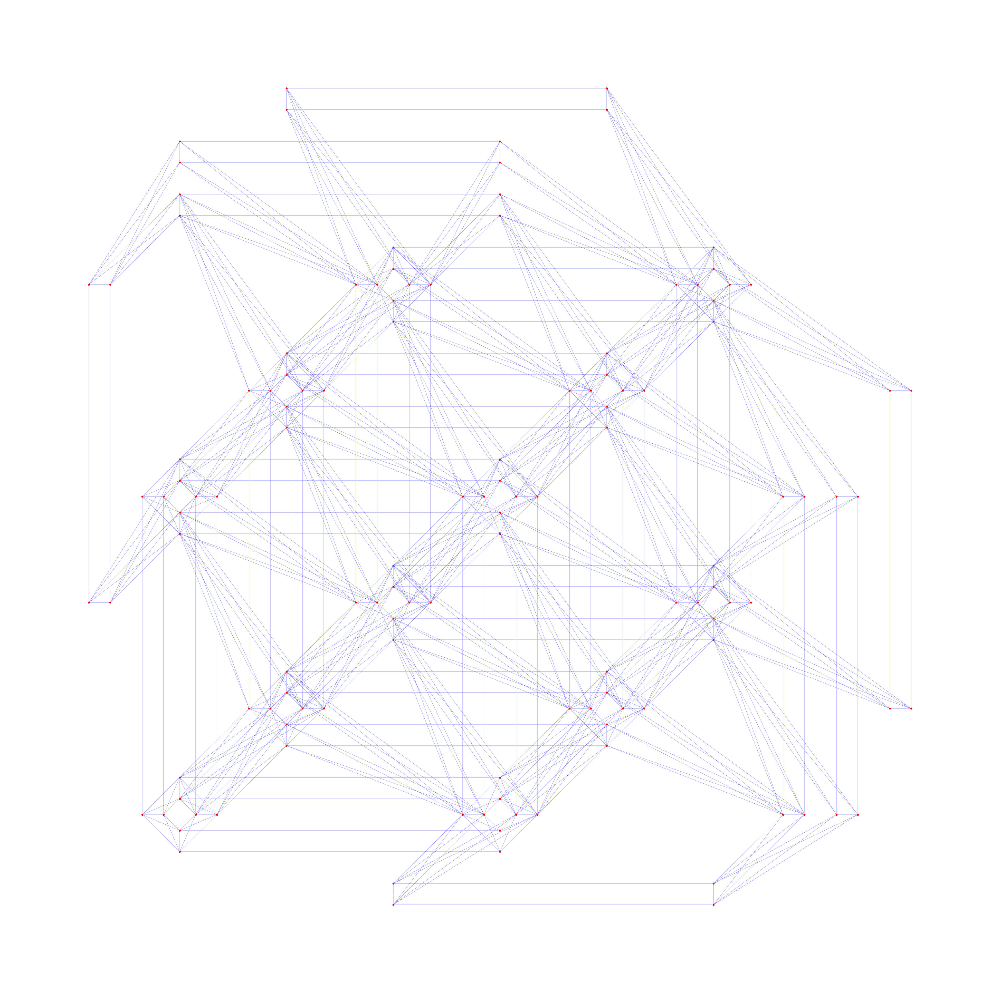

In [6]:
import dwave_networkx as dnx
import matplotlib.pyplot as plt

H = dnx.pegasus_graph(3)
f, axes = plt.subplots(1, 1, figsize=(50, 50))
dnx.draw_pegasus(H, crosses=True, node_color="red", edge_color='blue', ax=axes, width=0.3, node_size=20)
plt.savefig("pegasus_lowq", dpi=50)
#plt.show()

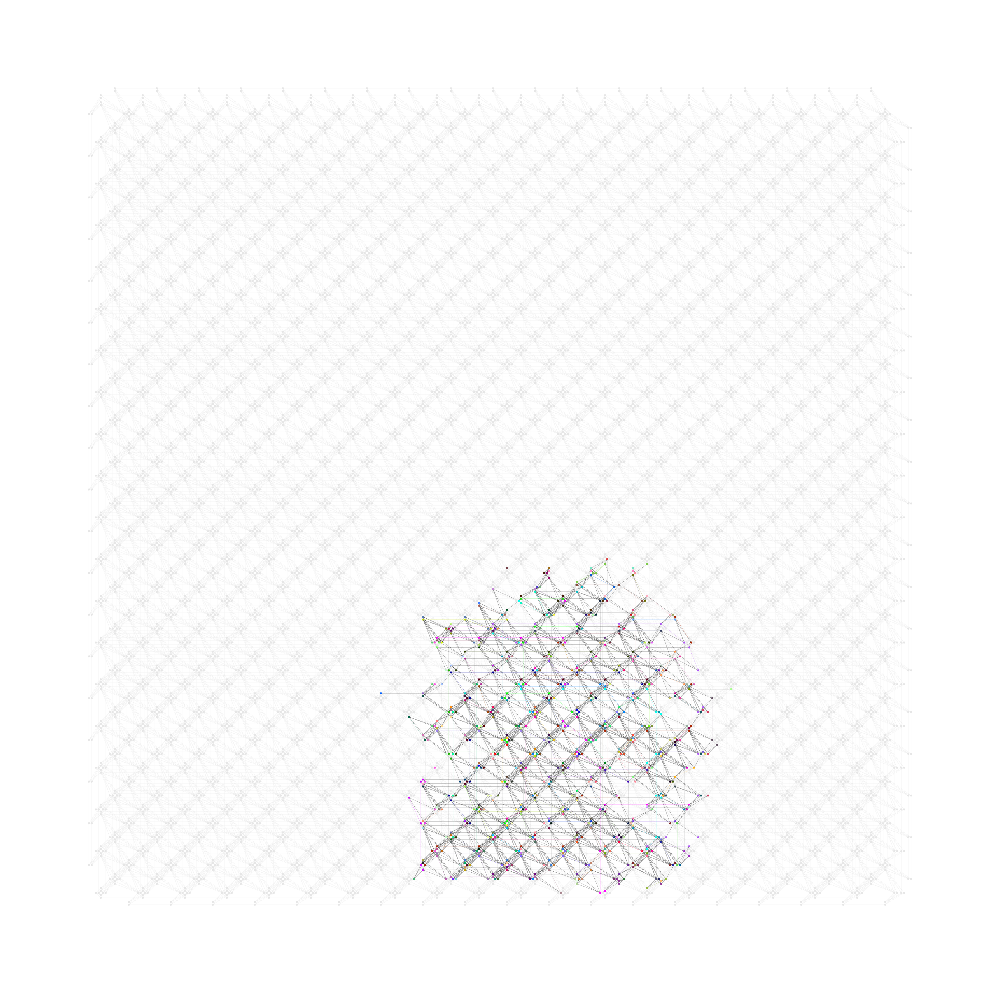

In [136]:
import dwave_networkx as dnx
import matplotlib.pyplot as plt

f, axes = plt.subplots(1, 1, figsize=(50, 50))
dnx.draw_pegasus_embedding(G, emb=emb_big, crosses=True, ax=axes, width=0.3, node_size=20)
plt.savefig("pegasus_embedding_medium_lowq", dpi=50)
plt.show()

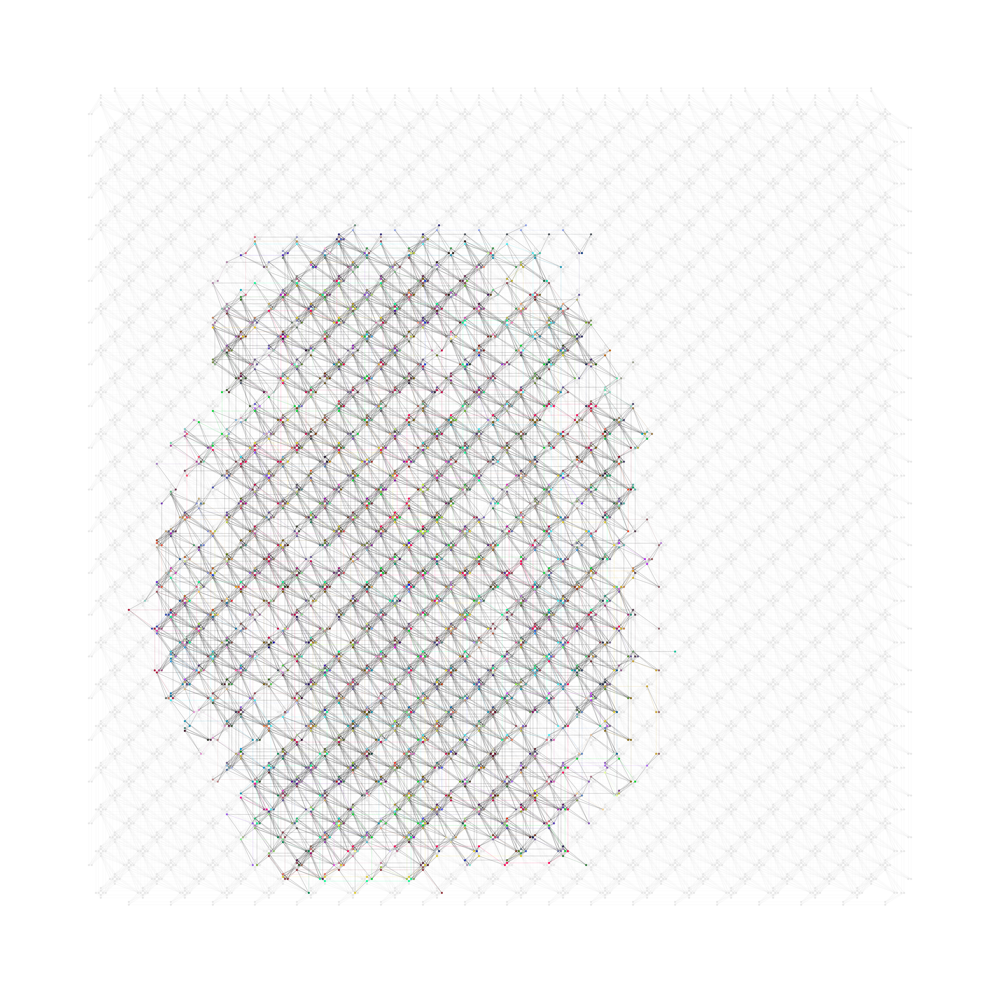

In [137]:
import dwave_networkx as dnx
import matplotlib.pyplot as plt

f, axes = plt.subplots(1, 1, figsize=(50, 50))
dnx.draw_pegasus_embedding(G, emb=emb_huge, crosses=True, ax=axes, width=0.3, node_size=20)
plt.savefig("pegasus_embedding_huge_lowq", dpi=50)
plt.show()

# Fetch and setup Dataset

In [62]:
def data_to_matrix(x):
    x_data = np.zeros((len(x),123))
    exists = np.zeros(123)
    for i,x_i in enumerate( x ):
        for j in range(123):
            if j in x_i.keys():
                assert x_i[j] == 1
                x_data[i,j] = 1.
                exists[j] = 1.
    return x_data, exists

In [63]:
def set_up_data(sel=3):

    global y
    #global x_test
    global y_test
    global select
    global x_data_reduced
    global x_test_data_reduced


    y, x = svm_read_problem(DATA +'/a1a')
    y_test, x_test = svm_read_problem(DATA +'/a1a.t')
    np.random.seed(2)
    train_indexes = list(range(len(y)))
    np.random.shuffle(train_indexes)
    y = [y[i] for i in train_indexes]
    x = [x[i] for i in train_indexes]
    x_data, exists = data_to_matrix(x)
    x_test_data, exists_test = data_to_matrix(x_test)

    if sel== 0.3:
        select = np.mean(x_data,0) > .3
        np.array(range(123))[select]
    elif sel== 7:     ### selects 7 features
        select = (((np.mean(x_data,0) > .3) + 0.) + (np.mean(x_data,0) < .65)) == 2.
        np.array(range(123))[select]
    elif sel== 9:      ### selects 9 features
        select = (((np.mean(x_data,0) > .3) + 0.) + (np.mean(x_data,0) < .7)) == 2.
        np.array(range(123))[select]
        
    elif sel== 15:      ### selects 15 features
        select = (((np.mean(x_data,0) > .21) + 0.) + (np.mean(x_data,0) < .79)) == 2.
        np.array(range(123))[select]
        
    elif sel == 3:      ### selects 3 features
        select = np.array([False for i in range(123)])
        select[6] = True
        select[22] = True
        select[36] = True
        select
    elif sel== 'all':
        select = np.array([True for i in range(123)])
    else:
        assert False

    x_data_reduced = x_data[:,select]
    x_test_data_reduced = x_test_data[:,select]
    
    # convert from (-1, 1) to {0, 1}
    y = 0+(np.array(y) > 0.)
    y_test = 0+(np.array(y_test) > 0.)

# Create Binary Neural Network

In [64]:
class BinarizeF(Function):

    @staticmethod
    def forward(cxt, input):
        output = input.new(input.size())
        output[input >= 0] = 1
        output[input < 0] = -1
        return output

    @staticmethod
    def backward(cxt, grad_output):
        grad_input = grad_output.clone()
        return grad_input

# aliases
binarize = BinarizeF.apply

class BinaryTanh(nn.Module):
    def __init__(self):
        super(BinaryTanh, self).__init__()
        self.hardtanh = nn.Hardtanh()

    def forward(self, input):
        output = self.hardtanh(input)
        output = binarize(output)
        
        if num_classes == 2:
            output += 1
            output /= 2
            output = output.squeeze()
        return output
        

class BinaryLinear(nn.Linear):

    def forward(self, input):
        binary_weight = binarize(self.weight)
        if self.bias is None:
            return F.linear(input, binary_weight)
        else:
            return F.linear(input, binary_weight, self.bias)

    def reset_parameters(self):
        # Glorot initialization
        in_features, out_features = self.weight.size()
        stdv = math.sqrt(1.5 / (in_features + out_features))
        self.weight.data.uniform_(-stdv, stdv)
        if self.bias is not None:
            self.bias.data.zero_()

        self.weight.lr_scale = 1. / stdv

In [65]:
## Define the NN architecture
class BinaryNet(nn.Module):
    def __init__(self):
        super(BinaryNet, self).__init__()
        self.fc_list = nn.ModuleList()
        if num_classes == 2:
            output_net_size = 1
        else:
            output_net_size = num_classes
        input_layer_size = input_size
        output_layer_size = hidden_n
        
        for i in range(n_layers):
            if i == n_layers -1:
                output_layer_size = output_net_size
            self.fc_list.append( BinaryLinear(input_layer_size, output_layer_size, bias=False) )
            input_layer_size = hidden_n
            
        self.dropout = nn.Dropout(0.2)
        self.activation = BinaryTanh()

    def forward(self, x):
        # flatten image input
        x = x.view(-1, input_size)
        # add hidden layer, with relu activation function
        for fc_layer in self.fc_list:
            x = self.activation(fc_layer(x))
        return x

# Create QUBO Model

In [66]:
# crear variables weights de tipo bool
def set_up_qubo_model(model, layers_to_optimize=[1,2]):
    qubo_vars = {}
    for j_layer in layers_to_optimize:
        for i in range( getattr(model, 'fc_list')[j_layer].weight.shape[0] ):
            for k in range( getattr(model, 'fc_list')[j_layer].weight.shape[1] ):
                qubo_vars[f'weight_{j_layer}_{i}_{k}'] = boolean_var( f'weight_{j_layer}_{i}_{k}' )
    H = PCBO()

    return qubo_vars, H

In [67]:
def add_constraint_greater_zero( count, partial_poly, output_bool, lam, k_layer, j, image_index, H):
    # count is the number of terms in the sum of the neurons
    
    if count < 4:
        aux = 1
        aux_1 =  boolean_var(f'aux_matrix_product_{k_layer}_{j}_{image_index}_{aux}')
        aux_2 = output_bool
        H.add_constraint_eq_zero( -aux_1 -2*aux_2 + partial_poly, lam=lam)
    elif count < 8:
        aux = 1
        aux_1 =  boolean_var(f'aux_matrix_product_{k_layer}_{j}_{image_index}_{aux}')
        aux = 2
        aux_2 =  boolean_var(f'aux_matrix_product_{k_layer}_{j}_{image_index}_{aux}')
        aux_4 = output_bool
        H.add_constraint_eq_zero( -aux_1 -2*aux_2 -4*aux_4 + partial_poly, lam=lam)
    elif count < 16:
        aux = 1
        aux_1 =  boolean_var(f'aux_matrix_product_{k_layer}_{j}_{image_index}_{aux}')
        aux = 2
        aux_2 =  boolean_var(f'aux_matrix_product_{k_layer}_{j}_{image_index}_{aux}')
        aux = 4
        aux_4 =  boolean_var(f'aux_matrix_product_{k_layer}_{j}_{image_index}_{aux}')
        aux_8 = output_bool
        H.add_constraint_eq_zero( -aux_1 -2*aux_2 -4*aux_4 -8*aux_8 + partial_poly, lam=lam)
    else:
        assert False

    return H

In [68]:
def add_constrains_qubo(input_x, gt, model, qubo_vars, H, img_idx, Lambda=1, layers_to_optimize=[0, 1]):
    # loop over layers to optimize
    for k_layer_i in range(len(layers_to_optimize)):
        k_layer = layers_to_optimize[k_layer_i]
        if k_layer_i == 0:
            fc_in = input_x
            
        # loop over output dimension of layer
        for j in range(  getattr(model, 'fc_list')[k_layer].weight.shape[0]  ):
            partial = 0.
            count = 0.

            # loop over input dimension of layer
            for i in range( getattr(model, 'fc_list')[k_layer].weight.shape[1] ):

                qubo_vars[f'partial_matrix_product_{k_layer}_{i}_{j}_{img_idx}'] = boolean_var(f'partial_matrix_product_{k_layer}_{i}_{j}_{img_idx}')
                # the first layer does not require xnor
                if k_layer_i == 0:
                    
                    # si input es 1
                    if fc_in[i] == 1:
                        H.add_constraint_eq_BUFFER(
                                    qubo_vars[f'partial_matrix_product_{k_layer}_{i}_{j}_{img_idx}'],
                                    qubo_vars[f'weight_{k_layer}_{j}_{i}'],
                                    #lam=Lambda/getattr(model, 'fc_list')[k_layer].weight.shape[0]
                                    lam=Lambda
                                                  )
                    # si input es 0
                    if fc_in[i] == 0:
                        H.add_constraint_eq_NOT( 
                                     qubo_vars[f'partial_matrix_product_{k_layer}_{i}_{j}_{img_idx}'],
                                     qubo_vars[f'weight_{k_layer}_{j}_{i}'],
                                     lam=Lambda
                                               )
                else:
                    H.add_constraint_eq_XNOR(
                                    qubo_vars[f'partial_matrix_product_{k_layer}_{i}_{j}_{img_idx}'],
                                    qubo_vars[f'weight_{k_layer}_{j}_{i}'],
                                    fc_in[i] ,
                                    lam=Lambda
                                            )
                partial += qubo_vars[f'partial_matrix_product_{k_layer}_{i}_{j}_{img_idx}']
                count +=1.
            qubo_vars[f'matrix_product_{k_layer}_{j}_{img_idx}'] = boolean_var(f'matrix_product_{k_layer}_{j}_{img_idx}')


            H = add_constraint_greater_zero( count,
                                        partial,
                                        output_bool=qubo_vars[f'matrix_product_{k_layer}_{j}_{img_idx}'],
                                        lam=Lambda,
                                        k_layer=k_layer,
                                        j=j,
                                        image_index=img_idx,
                                        H=H
                                       )

        fc_in = [ qubo_vars[f'matrix_product_{k_layer}_{j}_{img_idx}'] for j in range( getattr(model, 'fc_list')[k_layer].weight.shape[0] ) ]

    k_layer = 'loss'
    qubo_vars[f'matrix_product_{k_layer}_{0}_{img_idx}'] = boolean_var(f'matrix_product_{k_layer}_{0}_{img_idx}')
    
    if gt == 0:
        H.add_constraint_eq_BUFFER(  qubo_vars[f'matrix_product_{k_layer}_{0}_{img_idx}'],  fc_in[0] , lam=Lambda)
    if gt == 1:
        H.add_constraint_eq_NOT(  qubo_vars[f'matrix_product_{k_layer}_{0}_{img_idx}'], fc_in[0] , lam=Lambda)
    H += qubo_vars[f'matrix_product_{k_layer}_{0}_{img_idx}']   

    img_idx += 1
        
    return H, img_idx

In [69]:
# empty dict with keys created
# keys are weights for both layers
def set_up_weights_biases(model, layers_to_optimize=[1,2]):
    weights_biases = {} ## dict of variables
    for j_layer in layers_to_optimize:   ## second and third layer
        for i in range( getattr(model, 'fc_list')[j_layer].weight.shape[0] ):
            for k in range( getattr(model, 'fc_list')[j_layer].weight.shape[1] ):
                weights_biases[f'weight_{j_layer}_{i}_{k}'] = 0.
    
    return weights_biases


def set_up_weights_biases_hard_c(model, layers_to_optimize=[1,2]):
    weights_biases_hard_c = {} ## dict of variables
    for j_layer in layers_to_optimize:   ## second and third layer
        for i in range( getattr(model, 'fc_list')[j_layer].weight.shape[0] ):
            for k in range( getattr(model, 'fc_list')[j_layer].weight.shape[1] ):
                weights_biases_hard_c[f'spin_{j_layer}_{i*sum(select) + k}'] = 0.

    return weights_biases_hard_c

# Soft Gurobi Model

In [70]:
def set_up_grb_model_qubo(target_qubo_0, const=0):
    grb_model = grb.Model()
    grb_model.setParam('OutputFlag', False)
    grb_model.setParam('Threads', 1)

    # First add the input variables as Gurobi variables.
    gurobi_vars = []
    v = grb_model.addVar( vtype=grb.GRB.BINARY, name=f'x')
    grb_model.update()
    gurobi_vars.append(v)


    grb_loss = 0
    grb_model.update()

    for (i,j) in target_qubo_0:
        v = grb_model.getVarByName(f"{i}")

        # variable i no existe en el modelo
        if v is None:
            v = grb_model.addVar( vtype=grb.GRB.BINARY, name=f'{i}')
            gurobi_vars.append(v)
        grb_model.update()
        w = grb_model.getVarByName(f"{j}")

         # variable j no existe en el modelo
        if w is None:
            w = grb_model.addVar( vtype=grb.GRB.BINARY, name=f'{j}')
            gurobi_vars.append(w)
        grb_model.update()
        grb_loss += v*w*target_qubo_0[(i,j)]
        grb_model.update()
    grb_loss += const
    grb_model.update()

    return grb_model, grb_loss

# Hard Gurobi Model

In [71]:
def set_up_gurobi_model_hard_c(nn_model, weights_biases_hard_c, layers_to_optimize=[0,1]):
    grb_model_hard_c = grb.Model()
    grb_model_hard_c.setParam('OutputFlag', False)
    grb_model_hard_c.setParam('Threads', 1)

    grb_loss_hard_c = 0
    
    # First add the input variables as Gurobi variables.
    gurobi_vars_hard_c = []
    #binary_vars = []
    for j_layer in layers_to_optimize:
        for i in range( np.prod( getattr(nn_model, 'fc_list')[j_layer].weight.shape ) ):
            # grb no tiene variable de tipo SPIN
            # la creamos manualmente con una variable binaria
            # y otra variable continua, mas una restriccion
            v = grb_model_hard_c.addVar( vtype=grb.GRB.BINARY,
                                          name=f'N_{j_layer}_{i}')
            
            
            # aqui a lo mejor se puedo poner el upper bound a 1
            c = grb_model_hard_c.addVar(vtype=grb.GRB.CONTINUOUS, lb=-1, name= f'spin_{j_layer}_{i}')
            grb_model_hard_c.addConstr( c == v*2 -1 )
            gurobi_vars_hard_c.append(c)

            grb_loss_hard_c += c*weights_biases_hard_c[f'spin_{j_layer}_{i}'] ## bias term for online training

    grb_model_hard_c.update()


    return grb_model_hard_c, grb_loss_hard_c, gurobi_vars_hard_c

In [72]:
def add_constrains_hard_c( input_x, gt , batch_index, nn_model, grb_model_hard_c, gurobi_vars_hard_c, grb_loss_hard_c,
                          layers_to_optim=[0, 1]):
    target_index_i = [(gt>0)*2-1]
    eps = 1e-5

    
    layer_start = 0
    for k_layer_i in range(len(layers_to_optim)):
        k_layer = layers_to_optim[k_layer_i]
        if k_layer_i == 0:
            fc_in = (input_x>0)*2-1
        else:
            layer_start += np.prod(getattr(nn_model, 'fc_list')[layers_to_optim[k_layer_i-1]].weight.shape)
            fc_in =  gurobi_vars_hard_c[-getattr(nn_model, 'fc_list')[k_layer].weight.shape[1] : ]
        for i in range(  getattr(nn_model, 'fc_list')[k_layer].weight.shape[0]  ):
            v = grb_model_hard_c.addVar( vtype=grb.GRB.BINARY,
                                          name=f'N_{batch_index}_{k_layer}_{i}')
            c = grb_model_hard_c.addVar(vtype=grb.GRB.CONTINUOUS, lb=-1, name= f'out_{batch_index}_{k_layer}_{i}')
            grb_model_hard_c.addConstr( c == v*2 -1 )
            gurobi_vars_hard_c.append(c)
        grb_model_hard_c.update()

        ### loop over output dimension of layer
        for j in range(  getattr(nn_model, 'fc_list')[k_layer].weight.shape[0]  ):
            partial_matrix_product = []
            ### loop over input dimension of layer
            for i in range( getattr(nn_model, 'fc_list')[k_layer].weight.shape[1] ):   ## loop over input dimension of layer
                b = grb_model_hard_c.addVar(vtype=grb.GRB.CONTINUOUS, lb=-1, name= f'partial_matrix_product_{batch_index}_{k_layer}_{i}_{j}')
                grb_model_hard_c.update()
                grb_model_hard_c.addConstr( b == gurobi_vars_hard_c[layer_start +i+ getattr(nn_model, 'fc_list')[k_layer].weight.shape[1]*j] * fc_in[i] )
                grb_model_hard_c.update()
                partial_matrix_product.append(b)
                
            grb_model_hard_c.addConstr( eps <=  sum(partial_matrix_product) * gurobi_vars_hard_c[-getattr(nn_model, 'fc_list')[k_layer].weight.shape[0] + j] )
        grb_model_hard_c.update()

    check_vrb_i_abs = grb_model_hard_c.addVar(vtype=grb.GRB.CONTINUOUS, lb=0, name= f'loss_abs_{batch_index}')
    check_vrb_i = grb_model_hard_c.addVar(vtype=grb.GRB.CONTINUOUS, lb=-1, name= f'loss_{batch_index}')
    grb_model_hard_c.update()
    
    # funcion objetivo
    grb_model_hard_c.addConstr( check_vrb_i ==  (gurobi_vars_hard_c[-1] - target_index_i[0] )/2.)
    grb_model_hard_c.update()
    grb_model_hard_c.addConstr( check_vrb_i_abs == grb.abs_( check_vrb_i ) )
    grb_model_hard_c.update()
    grb_loss_hard_c += check_vrb_i_abs
    grb_model_hard_c.update()


    return grb_model_hard_c, grb_loss_hard_c, gurobi_vars_hard_c

# Extract Results

In [73]:
def evaluate_solution(qubo, x):
    result = 0
    for (i,j) in qubo:
        result += qubo[(i,j)]*x[i]*x[j]
    return result

In [74]:
def feed_forward_qubo_nn(H_solution, test_data, input_size, hidden_n, n_layers, plot_images=False):    
    data = test_data
    
    test_images = data.shape[0]

    input_layer_size = input_size
    output_layer_size = hidden_n


    # Create a list of matrices that
    # contain the weights of each layer
    w_list = []
    for layer in range(n_layers):
        if layer == n_layers-1:
            output_layer_size = 1
        w_list.append(
                     np.array([[H_solution[f'weight_{layer}_{j}_{i}'] for i in range(input_layer_size)] for j in range(output_layer_size)])
                     )
        input_layer_size = hidden_n  


    # convert from Binary to Ising 2x - 1  
    for layer in range(n_layers):
        w_list[layer] *=2
        w_list[layer] -=1

    
    if plot_images:
        for layer in range(n_layers):
            plt.figure()
            plt.imshow(w_list[layer], cmap='gray')   


    out = []
    for index_i in range(test_images):
        # flatten data
        in_x = data[index_i].flatten()
        # convert to ising
        in_x = (in_x > 0.5)*2 -1
        # calculate result of model
        for layer in range(n_layers):
            in_x = w_list[layer] @ in_x     
            # binarize layer output 
            in_x = (np.array(in_x) > 0)*2 -1

        out.append( in_x )

    out = np.array(out)
    results = (out > 0.5)*1.
    results = results.reshape((test_data.shape[0]) )
    return results

In [75]:
def mycallback_time(model, where):
    global grb_time
    
    # MIP = Mixedd Integer Program
    if where == grb.GRB.Callback.MIP:
        _time = model.cbGet(grb.GRB.Callback.RUNTIME)
        best = model.cbGet(grb.GRB.Callback.MIP_OBJBST)
        cur_bd = model.cbGet(grb.GRB.Callback.MIP_OBJBND)

        grb_train.append((_time,best, cur_bd))
        if _time > grb_time and best < grb.GRB.INFINITY:
            model.terminate()
            print(_time, best, cur_bd)
print_time_ = -1

# Training

In [132]:
optimization_type = 'sym_anneal_soft_embedded_qubo'
sym_anneal_num_anneals = 500

num_vars = 4
name = f'SYM ANNEAL eQUBO {sym_anneal_num_anneals} {num_vars}'
emb_huge, bqm, target_bqm = train_models(neural_network, optimization_type, num_batches_to_run,
                   50, Lambda_qubo, hidden_n, sym_anneal_num_anneals, x_data_reduced, y, verbose=False)

In [141]:
grb_train = []
def train_models(nn_model, optimization_type, num_batches_to_run, data_per_batch, 
                 Lambda_qubo, hidden_n, num_anneals, x_data, y_data, alpha=0., verbose=True,
                 n_reads_qpu=2000):
    global dwave_qubo
    global grb_dwave_qubo_solution
    global grb_time
    global grb_train

    list_H_solutions = []
    list_results = []
    qpu_response = 1
    img_idx = 0

    # dictionary with weights
    # to update each batch
    weights_biases = set_up_weights_biases(nn_model, [0,1])
    weights_biases_hard_c = set_up_weights_biases_hard_c(nn_model, [0, 1])

    for batch_n in range(num_batches_to_run):

        #print("Start runtime")
        runtime = time.time()

        # empty model with variables type constraints
        qubo_vars, H = set_up_qubo_model(nn_model, [0,1])
        grb_model_hard_c, grb_loss_hard_c, gurobi_vars_hard_c = set_up_gurobi_model_hard_c(nn_model, weights_biases_hard_c, [0, 1])

        # add topology and input constraints to model
        for index_i in range(data_per_batch):
            in_x = x_data[batch_n*data_per_batch+index_i]
            in_x = 0+(in_x > 0.)
            H, img_idx = add_constrains_qubo(in_x, y_data[batch_n*data_per_batch+index_i], nn_model, qubo_vars, H, img_idx, Lambda=Lambda_qubo)
            grb_model_hard_c, grb_loss_hard_c, gurobi_vars_hard_c = add_constrains_hard_c( in_x, y_data[batch_n*data_per_batch+index_i], index_i, 
                                  nn_model, grb_model_hard_c, gurobi_vars_hard_c,
                                  grb_loss_hard_c, [0, 1])
            
        for key in weights_biases.keys():
             # correct biases with running average of past solutions 
            H[(key,)] += weights_biases[key]               


        # convert to qubo 
        H_qubo = H.to_qubo()
        dwave_qubo = H_qubo.Q   
        
        if 'embedded_qubo' in optimization_type:
            # find dwave embedding of qubo
            emb = find_embedding(dwave_qubo, G.edges, random_seed=10)
            bqm = BinaryQuadraticModel.from_qubo(dwave_qubo)
            target_bqm = dwave.embedding.embed_bqm(bqm, emb, G.adj) 
            
           
            target_qubo = target_bqm.to_qubo()
            #return emb, bqm, target_bqm
            if (batch_n == 0):
                print(f"Num variables usadas para qubo en dwave solver {target_bqm.num_variables}")



        if optimization_type == 'grb_hard_c':
            grb_model_hard_c.setObjective(grb_loss_hard_c, grb.GRB.MINIMIZE)

            grb_train = []
            grb_time=np.inf
            
            grb_model_hard_c.optimize(mycallback_time)

            if verbose:
                print(f"grb_hard_c number of variables {len(grb_model_hard_c.getVars())}")

            H_solution={}
            for ii in grb_model_hard_c.getVars():
                if 'spin' in ii.VarName:
                    
                    ii.VarName.split('_')
                    layer_i = int(ii.VarName.split('_')[1])
                    if layer_i == 0:
                        _x = int(ii.VarName.split('_')[2]) % sum(select)   ### TO DO: fix this!
                        _y = int(ii.VarName.split('_')[2]) // sum(select)
                    else:
                        _x = int(ii.VarName.split('_')[2]) % hidden_n   ### TO DO: fix this!
                        _y = int(ii.VarName.split('_')[2]) // hidden_n
                        
                    H_solution[f'weight_{layer_i}_{_y}_{_x}'] = (ii.x+1)/2.
                    weights_biases_hard_c[ii.VarName] += -alpha* ii.x

        
        elif optimization_type == 'sym_anneal_soft_qubo':
            res = anneal_pubo(H, num_anneals=num_anneals)
            H_solution = res.best.state

            if (verbose):
                print("Model value:", res.best.value)
                print("Constraints satisfied?", H.is_solution_valid(H_solution))
            
        elif optimization_type == 'grb_soft_qubo':
            grb_model, grb_loss = set_up_grb_model_qubo(dwave_qubo, const=H_qubo[()])
            
            grb_model.setObjective(grb_loss, grb.GRB.MINIMIZE)
            grb_train = []
            grb_time=np.inf
            grb_model.optimize(mycallback_time)

            grb_model.getVars()
            grb_dwave_qubo_solution={}
            for i in grb_model.getVars():
                if i.VarName != 'x':
                    grb_dwave_qubo_solution[int(i.VarName)] = i.x
            H_solution = H.convert_solution(grb_dwave_qubo_solution)

        elif optimization_type == 'grb_soft_embedded_qubo':
            grb_model, grb_loss = set_up_grb_model_qubo(target_qubo[0])
            grb_model.setObjective(grb_loss, grb.GRB.MINIMIZE)
            grb_train = []
            grb_time=np.inf
            grb_model.optimize(mycallback_time)
            
            grb_target_qubo_solution={}
            for i in grb_model.getVars():
                if i.VarName != 'x':
                    grb_target_qubo_solution[int(i.VarName)] = i.x
            unembedded_results_from_grb_target_qubo_solution = {}
            for i in range(bqm.num_variables):
                _results_ = []
                for j in emb[i]:
                    _results_.append(grb_target_qubo_solution[j])
                unembedded_results_from_grb_target_qubo_solution[i] = np.mean(_results_)
                #assert  np.mean(_results_) == 0 or np.mean(_results_) == 1

            H_solution = H.convert_solution(unembedded_results_from_grb_target_qubo_solution)

        elif optimization_type == 'sym_anneal_soft_embedded_qubo':
            target_qubo_res = anneal_qubo(target_qubo[0], num_anneals=num_anneals)
            target_qubo_solution = target_qubo_res.best.state

            if verbose:
                print("Model value:", target_qubo_res.best.value)

            unembedded_results_from_target_qubo_solution = {}
            for i in range(bqm.num_variables):
                _results_ = []
                for j in emb[i]:
                    _results_.append(target_qubo_solution[j])
                unembedded_results_from_target_qubo_solution[i] = np.mean(_results_)
            H_solution = H.convert_solution(unembedded_results_from_target_qubo_solution)

        
        elif optimization_type == 'quantum_anneal_soft_embedded_qubo':
            qpu_response = 0
            n_reads = n_reads_qpu
            response = solver.sample_bqm(target_bqm, num_reads=n_reads)#, chain_strength=2*L) 

            return response, target_bqm, bqm, emb
            response_result = response.result()
            unembedded_results = {}
            for i in range(bqm.num_variables):
                _results_ = []
                for j in emb[i]:
                    _results_.append(response_result['solutions'][0][j])
                unembedded_results[i] = np.mean(_results_)

            H_solution = H.convert_solution(unembedded_results)
            
            qpu_response = [ dict(response_result), emb]


        runtime = time.time() - runtime

        for key in weights_biases.keys():
            weights_biases[key] +=  -alpha*(2*H_solution[key]-1)
        list_H_solutions.append(H_solution)


        y_correct_batch = y_data[batch_n*data_per_batch:(batch_n+1)*data_per_batch]
        x_data_batch = x_data[batch_n*data_per_batch:(batch_n+1)*data_per_batch]
        predictions = feed_forward_qubo_nn( H_solution, x_data_batch, input_size, hidden_n, n_layers)
        right_on_train = (sum((predictions> 0.5) == y_correct_batch))
        accuracy = right_on_train / len(predictions)
        list_results.append( ( batch_n, accuracy, runtime, qpu_response, right_on_train )    )

        if (verbose):
            print()
            print(f"----- BATCH {batch_n} RESULTS -----")
            print(f"Predictions: {predictions}")
            print(f"Correct predictions: {y_correct_batch}")
            print(f"Prediction correct? : {(predictions > 0.5) == y_correct_batch}" )
            print(f"Accuracy {accuracy}")


    return list_results

# Plotting and others

In [19]:
def create_plots(opt_type, n_batches, results, baseline_vals, baseline_opt_type='grb_hard_c'):

  plt.figure()
  plt.title('time ' + opt_type)
  plt.hist( [ results[i][2]     for i in range(n_batches)], range=(0, 1))
  plt.hist( [ baseline_vals[i][2]     for i in range(n_batches)], range=(0, 1))
  plt.legend([opt_type, baseline_opt_type])
  plt.xlim([0, None])
  plt.xlabel("seconds")

  plt.figure()
  plt.title('distance from optimum ' + opt_type)
  plt.hist( [ results[i][1]     for i in range(n_batches)])
  plt.hist( [ baseline_vals[i][1]     for i in range(n_batches)])
  plt.legend([opt_type, baseline_opt_type])
  plt.xlim([0, None])


  """
  plt.figure()
  plt.title('distance from optimum vs time ' + opt_type)
  
  plt.plot( [ results[i][2]     for i in range(n_batches)],
          [ results[i][1]     for i in range(n_batches)],
          '.'
        )

  plt.plot( [ baseline_vals[i][2]     for i in range(n_batches)],
          [ baseline_vals[i][1]     for i in range(n_batches)],
          '.'
        )
  plt.xscale('log')
  
  plt.legend([opt_type, baseline_opt_type])"""

In [173]:
def create_plots_2(result_one, result_two, baseline_one, baseline_two, method=None):
  plt.rcParams.update({'font.size': 8})
  plt.figure(figsize=(8, 2))
  upper_limit = 100
  bins = np.logspace(np.log10(0.01), np.log10(upper_limit), 50)
  plt.hist( [ result_one[i][2] for i in range(len(result_one))], alpha=0.5, bins=bins)
  plt.hist( [ result_two[i][2] for i in range(len(result_two))], alpha=0.5, bins=bins)
  plt.title(f"Runtime of {method}", fontsize=15)
  plt.xscale('log')
  plt.xlim([0.01, upper_limit])
  plt.yticks([0, 5, 10])
  plt.xlabel("time (s)", fontsize=11)

  plt.figure(figsize=(8, 2))
  plt.hist( [ baseline_one[i][4] - result_one[i][4] for i in range(len(result_one))], range=(0, 1), alpha=0.5, bins=range(0, 15))
  plt.hist( [ baseline_two[i][4] - result_two[i][4] for i in range(len(result_two))], range=(0, 1), alpha=0.5, bins=range(0, 15))
  plt.yticks([0, 5, 10])
  plt.title(f"Distance of {method}", fontsize=15)
  plt.xlabel('distance', fontsize=11)
  plt.xlim([0, 15])

In [21]:
def print_run_info(input_size, hidden_n, n_layers, selected_to_train, num_batches_to_run, sym_anneal_num_anneals):
    print(f"Input size: {input_size}")
    print(f"Hidden size: {hidden_n}")
    print(f"Number of layers {n_layers}")
    print(f"Batch size {selected_to_train}")
    print(f"Number of batches {num_batches_to_run}")
    print(f"Number anneals {sym_anneal_num_anneals}")

In [107]:
def load_result(name, dir=None):
    loc = 'results_'+name+'.pkl'
    if dir != None:
        loc = dir + 'results_'+name+'.pkl'

    with open(loc, 'rb') as handle:
        data = pickle.load(handle)
    return data

# Experiment 1

In [77]:
alpha = 0.
Lambda_qubo = 50
selected_to_train = 15   ### "batch size"

#sym_anneal_num_anneals = 4000   ### how many anneals in sym annealing
sym_anneal_num_anneals = 500   ### how many anneals in sym annealing
num_batches_to_run =  10   ### number of batches to run

all_results_dict = {}

In [78]:
set_up_data(3)             ### keep three data as input
input_size = sum(select)
hidden_n = 3              ### num hidden layers
num_classes = 2            ### binary 
n_layers = 2               ### num layers

# create the pytorch NN
neural_network = BinaryNet()
print(neural_network)

BinaryNet(
  (fc_list): ModuleList(
    (0): BinaryLinear(in_features=3, out_features=3, bias=False)
    (1): BinaryLinear(in_features=3, out_features=1, bias=False)
  )
  (dropout): Dropout(p=0.2, inplace=False)
  (activation): BinaryTanh(
    (hardtanh): Hardtanh(min_val=-1.0, max_val=1.0)
  )
)


## GRB HARD CONSTRAINT

In [26]:
optimization_type = 'grb_hard_c'

num_vars = 4
name = f'GRB HARD C {num_vars}'
result_one = train_models(neural_network, optimization_type, num_batches_to_run, 
                    num_vars, Lambda_qubo, hidden_n, sym_anneal_num_anneals, x_data_reduced, y, verbose=False)
baseline_result_one = result_one
all_results_dict[name] = result_one

with open('results_'+name+'.pkl', 'wb') as handle:
    pickle.dump(result_one, handle )


num_vars = 15
name = f'GRB HARD C {num_vars}'
result_two = train_models(neural_network, optimization_type, num_batches_to_run, 
                    num_vars, Lambda_qubo, hidden_n, sym_anneal_num_anneals, x_data_reduced, y, verbose=False)
baseline_result_two = result_two
all_results_dict[name] = result_two

with open('results_'+name+'.pkl', 'wb') as handle:
    pickle.dump(result_two, handle )

Set parameter WLSAccessID
Set parameter WLSSecret
Set parameter LicenseID to value 2515251
Academic license 2515251 - for non-commercial use only - registered to yl___@gmail.com


In [29]:
name = 'GRB HARD C 4'
all_results_dict[name] = load_result(name)

name = 'GRB HARD C 15'
all_results_dict[name] = load_result(name)

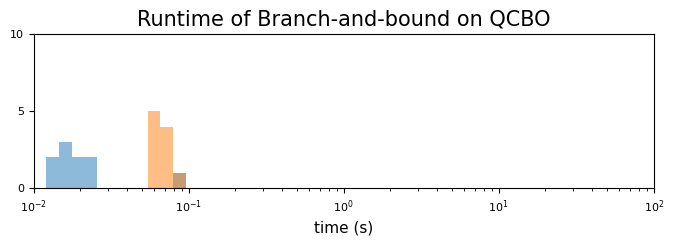

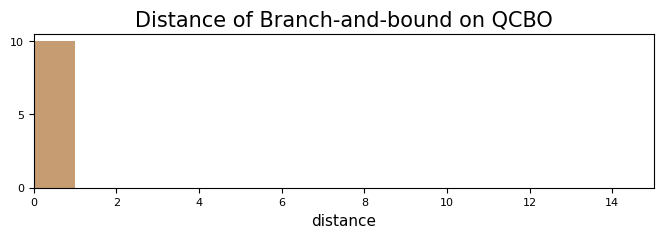

In [174]:
create_plots_2(all_results_dict['GRB HARD C 4'], all_results_dict['GRB HARD C 15'], all_results_dict['GRB HARD C 4'], all_results_dict['GRB HARD C 15'], method='Branch-and-bound on QCBO')

## GRB SOFT QUBO

In [116]:
optimization_type = 'grb_soft_qubo'

num_vars = 4
name = f'GRB SOFT QUBO {num_vars}'
result_one = train_models(neural_network, optimization_type, num_batches_to_run,
                    num_vars, Lambda_qubo, hidden_n, sym_anneal_num_anneals, x_data_reduced, y, verbose=False)
all_results_dict[name] = result_one

with open('results_'+name+'.pkl', 'wb') as handle:
    pickle.dump(result_one, handle )


num_vars = 15
name = f'GRB SOFT QUBO {num_vars}'
result_two = train_models(neural_network, optimization_type, num_batches_to_run,
                    num_vars, Lambda_qubo, hidden_n, sym_anneal_num_anneals, x_data_reduced, y, verbose=False)
all_results_dict[name] = result_two

with open('results_'+name+'.pkl', 'wb') as handle:
    pickle.dump(result_two, handle )


In [39]:
name = 'GRB SOFT QUBO 4'
all_results_dict[name] = load_result(name)

name = 'GRB SOFT QUBO 15'
all_results_dict[name] = load_result(name)

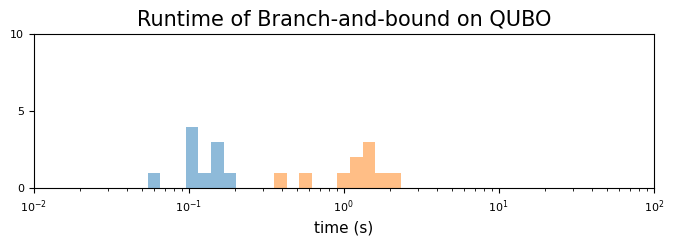

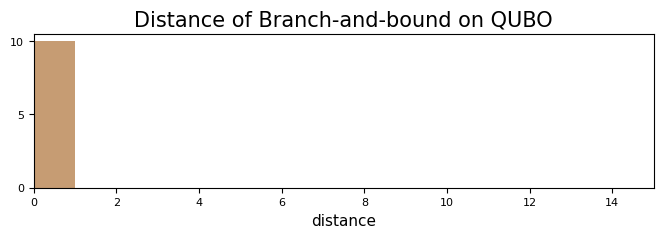

In [175]:
create_plots_2(all_results_dict['GRB SOFT QUBO 4'], all_results_dict['GRB SOFT QUBO 15'], all_results_dict['GRB HARD C 4'], all_results_dict['GRB HARD C 15'], method='Branch-and-bound on QUBO')

## GRB SOFT eQUBO

In [118]:
optimization_type = 'grb_soft_embedded_qubo'

num_vars = 4
name = f'GRB SOFT eQUBO {num_vars}'
result_one = train_models(neural_network, optimization_type, num_batches_to_run,
                    num_vars, Lambda_qubo, hidden_n, sym_anneal_num_anneals, x_data_reduced, y, verbose=False)
all_results_dict[name] = result_one

with open('results_'+name+'.pkl', 'wb') as handle:
    pickle.dump(result_one, handle )


num_vars = 15
name = f'GRB SOFT eQUBO {num_vars}'
result_two = train_models(neural_network, optimization_type, num_batches_to_run,
                    num_vars, Lambda_qubo, hidden_n, sym_anneal_num_anneals, x_data_reduced, y, verbose=False)
all_results_dict[name] = result_two

with open('results_'+name+'.pkl', 'wb') as handle:
    pickle.dump(result_two, handle )


Num variables usadas para qubo en dwave solver 168
Num variables usadas para qubo en dwave solver 864


In [41]:
name = 'GRB SOFT eQUBO 4'
all_results_dict[name] = load_result(name)

name = 'GRB SOFT eQUBO 15'
all_results_dict[name] = load_result(name)

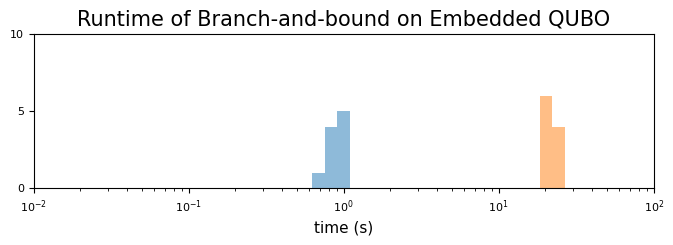

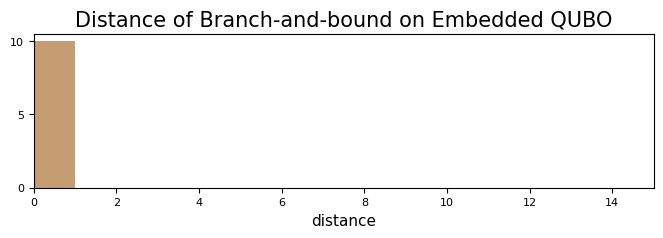

In [176]:
create_plots_2(all_results_dict['GRB SOFT eQUBO 4'], all_results_dict['GRB SOFT eQUBO 15'], all_results_dict['GRB HARD C 4'], all_results_dict['GRB HARD C 15'], method='Branch-and-bound on Embedded QUBO')

## SYM ANNEAL SOFT QUBO

In [136]:
optimization_type = 'sym_anneal_soft_qubo'
sym_anneal_num_anneals = 500   ### how many anneals in sym annealing

num_vars = 4
name = f'SYM ANNEAL QUBO {sym_anneal_num_anneals} {num_vars}'
result_one = train_models(neural_network, optimization_type, num_batches_to_run,
                    num_vars, Lambda_qubo, hidden_n, sym_anneal_num_anneals, x_data_reduced, y, verbose=False)
all_results_dict[name] = result_one

with open('results_'+name+'.pkl', 'wb') as handle:
    pickle.dump(result_one, handle )


num_vars = 15
name = f'SYM ANNEAL QUBO {sym_anneal_num_anneals} {num_vars}'
result_two = train_models(neural_network, optimization_type, num_batches_to_run,
                    num_vars, Lambda_qubo, hidden_n, sym_anneal_num_anneals, x_data_reduced, y, verbose=False)
all_results_dict[name] = result_two

with open('results_'+name+'.pkl', 'wb') as handle:
    pickle.dump(result_two, handle )

In [43]:
name = 'SYM ANNEAL QUBO 500 4'
all_results_dict[name] = load_result(name)

name = 'SYM ANNEAL QUBO 500 15'
all_results_dict[name] = load_result(name)

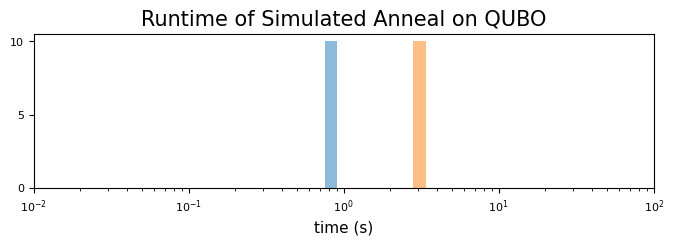

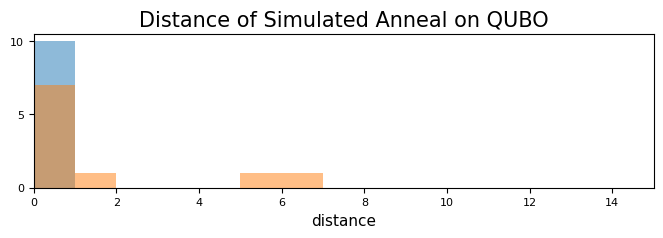

In [177]:
create_plots_2(all_results_dict['SYM ANNEAL QUBO 500 4'], all_results_dict['SYM ANNEAL QUBO 500 15'], all_results_dict['GRB HARD C 4'], all_results_dict['GRB HARD C 15'], method='Simulated Anneal on QUBO')

## SYM ANNEAL SOFT EMBEDDED QUBO

### 500 Anneals

In [138]:
optimization_type = 'sym_anneal_soft_embedded_qubo'
sym_anneal_num_anneals = 500

num_vars = 4
name = f'SYM ANNEAL eQUBO {sym_anneal_num_anneals} {num_vars}'
result_one = train_models(neural_network, optimization_type, num_batches_to_run,
                    num_vars, Lambda_qubo, hidden_n, sym_anneal_num_anneals, x_data_reduced, y, verbose=False)
all_results_dict[name] = result_one

with open('results_'+name+'.pkl', 'wb') as handle:
    pickle.dump(result_one, handle )


num_vars = 15
name = f'SYM ANNEAL eQUBO {sym_anneal_num_anneals} {num_vars}'
result_two = train_models(neural_network, optimization_type, num_batches_to_run,
                    num_vars, Lambda_qubo, hidden_n, sym_anneal_num_anneals, x_data_reduced, y, verbose=False)
all_results_dict[name] = result_two

with open('results_'+name+'.pkl', 'wb') as handle:
    pickle.dump(result_two, handle )

Num variables usadas para qubo en dwave solver 168
Num variables usadas para qubo en dwave solver 864


In [45]:
name = 'SYM ANNEAL eQUBO 500 4'
all_results_dict[name] = load_result(name)

name = 'SYM ANNEAL eQUBO 500 15'
all_results_dict[name] = load_result(name)

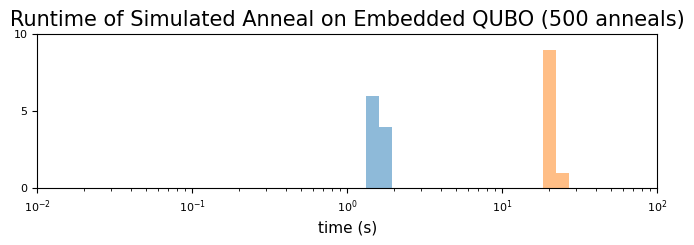

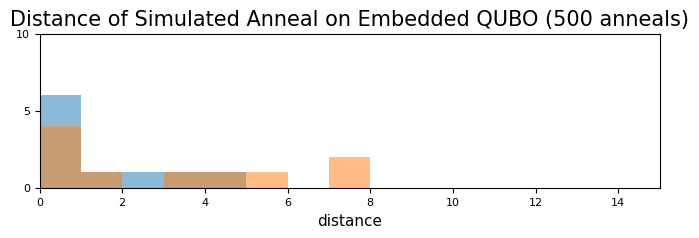

In [178]:
create_plots_2(all_results_dict['SYM ANNEAL eQUBO 500 4'], all_results_dict['SYM ANNEAL eQUBO 500 15'], all_results_dict['GRB HARD C 4'], all_results_dict['GRB HARD C 15'] , method='Simulated Anneal on Embedded QUBO (500 anneals)')

### 4000 Anneals

In [150]:
optimization_type = 'sym_anneal_soft_embedded_qubo'
sym_anneal_num_anneals = 4000

num_vars = 4
name = f'SYM ANNEAL eQUBO {sym_anneal_num_anneals} {num_vars}'
result_one = train_models(neural_network, optimization_type, num_batches_to_run,
                    num_vars, Lambda_qubo, hidden_n, sym_anneal_num_anneals, x_data_reduced, y, verbose=False)
all_results_dict[name] = result_one

with open('results_'+name+'.pkl', 'wb') as handle:
    pickle.dump(result_one, handle )


num_vars = 15
name = f'SYM ANNEAL eQUBO {sym_anneal_num_anneals} {num_vars}'
result_two = train_models(neural_network, optimization_type, num_batches_to_run,
                    num_vars, Lambda_qubo, hidden_n, sym_anneal_num_anneals, x_data_reduced, y, verbose=False)
all_results_dict[name] = result_two

with open('results_'+name+'.pkl', 'wb') as handle:
    pickle.dump(result_two, handle )

Num variables usadas para qubo en dwave solver 168
Num variables usadas para qubo en dwave solver 864


In [47]:
name = 'SYM ANNEAL eQUBO 4000 4'
all_results_dict[name] = load_result(name)

name = 'SYM ANNEAL eQUBO 4000 15'
all_results_dict[name] = load_result(name)

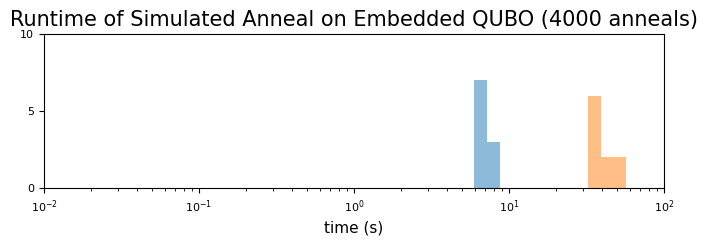

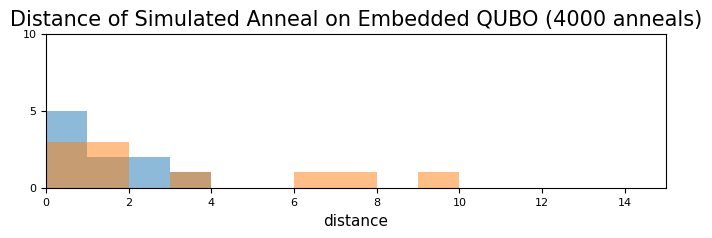

In [179]:
create_plots_2(all_results_dict['SYM ANNEAL eQUBO 4000 4'], all_results_dict['SYM ANNEAL eQUBO 4000 15'], all_results_dict['GRB HARD C 4'], all_results_dict['GRB HARD C 15'], method='Simulated Anneal on Embedded QUBO (4000 anneals)')

## QUANTUM ANNEAL SOFT EMBEDDED QUBO

In [153]:
n_reads_qpu = 2000
Lambda_qubo = 50
optimization_type = 'quantum_anneal_soft_embedded_qubo'

num_vars = 4
name = f'QUANTUM ANNEAL eQUBO {n_reads_qpu} {num_vars}'
result_one = train_models(neural_network, optimization_type, num_batches_to_run,
                    num_vars, Lambda_qubo, hidden_n, sym_anneal_num_anneals, x_data_reduced, y, verbose=False, n_reads_qpu=n_reads_qpu)
all_results_dict[name] = result_one

with open('results_'+name+'.pkl', 'wb') as handle:
    pickle.dump(result_one, handle )


num_vars = 15
name = f'QUANTUM ANNEAL eQUBO {n_reads_qpu} {num_vars}'
result_two = train_models(neural_network, optimization_type, num_batches_to_run,
                    num_vars, Lambda_qubo, hidden_n, sym_anneal_num_anneals, x_data_reduced, y, verbose=False, n_reads_qpu=n_reads_qpu)
all_results_dict[name] = result_two

with open('results_'+name+'.pkl', 'wb') as handle:
    pickle.dump(result_two, handle )

Num variables usadas para qubo en dwave solver 168
Num variables usadas para qubo en dwave solver 864


In [85]:
name = 'QUANTUM ANNEAL eQUBO 2000 4'
with open('results_'+name+'.pkl', 'wb') as handle:
    pickle.dump(all_results_dict[name], handle )

name = 'QUANTUM ANNEAL eQUBO 2000 15'
with open('results_'+name+'.pkl', 'wb') as handle:
    pickle.dump(all_results_dict[name], handle )

In [72]:
name = 'QUANTUM ANNEAL eQUBO 2000 4'
all_results_dict[name] = load_result(name)

name = 'QUANTUM ANNEAL eQUBO 2000 15'
all_results_dict[name] = load_result(name)

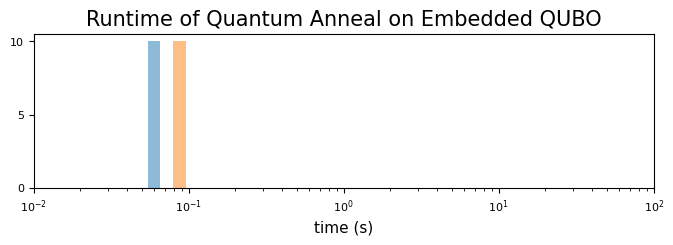

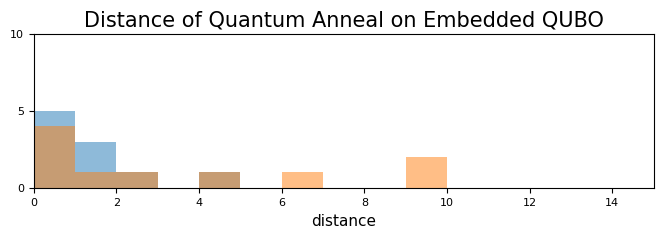

In [180]:
create_plots_2(all_results_dict['QUANTUM ANNEAL eQUBO 2000 4'], all_results_dict['QUANTUM ANNEAL eQUBO 2000 15'], all_results_dict['GRB HARD C 4'], all_results_dict['GRB HARD C 15'], method='Quantum Anneal on Embedded QUBO')

# Experiment 2

In [147]:
lambdas = [10, 50, 100]
alphas = [0., 0.01, 0.1]
num_anneals = [500, 1000, 2000]
num_batches_to_run = 10

In [149]:
optimization_type = 'sym_anneal_soft_embedded_qubo'
params_results = {}
params_combinations = {}

for l in lambdas:
    for a in alphas:
        for n_anneal in num_anneals:
            name = f'sym anneal equbo P: {l} anneals: {n_anneal} alpha: {a}'
            print(name)
            result = train_models(neural_network, optimization_type, num_batches_to_run,
                    4, l, hidden_n, n_anneal, x_data_reduced, y, alpha=a, verbose=False)
            params_results[name] = result   
            params_combinations[name] = [l, a, n_anneal]

sym anneal equbo P: 10 anneals: 500 alpha: 0.0
Num variables usadas para qubo en dwave solver 168
sym anneal equbo P: 10 anneals: 1000 alpha: 0.0
Num variables usadas para qubo en dwave solver 168
sym anneal equbo P: 10 anneals: 2000 alpha: 0.0
Num variables usadas para qubo en dwave solver 168
sym anneal equbo P: 10 anneals: 500 alpha: 0.01
Num variables usadas para qubo en dwave solver 168
sym anneal equbo P: 10 anneals: 1000 alpha: 0.01
Num variables usadas para qubo en dwave solver 168
sym anneal equbo P: 10 anneals: 2000 alpha: 0.01
Num variables usadas para qubo en dwave solver 168
sym anneal equbo P: 10 anneals: 500 alpha: 0.1
Num variables usadas para qubo en dwave solver 168
sym anneal equbo P: 10 anneals: 1000 alpha: 0.1
Num variables usadas para qubo en dwave solver 168
sym anneal equbo P: 10 anneals: 2000 alpha: 0.1
Num variables usadas para qubo en dwave solver 168
sym anneal equbo P: 50 anneals: 500 alpha: 0.0
Num variables usadas para qubo en dwave solver 168
sym anneal 

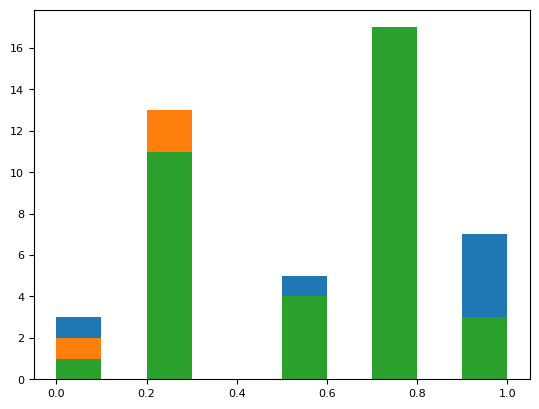

In [216]:
plt.figure()
for n_anneal in num_anneals:
    acc = []
    for l in lambdas:
        for a in alphas:
            res = params_results[name]
            name = f'sym anneal equbo P: {l} anneals: {n_anneal} alpha: {a}'
            #acc.append(np.mean([ res[i][1]     for i in range(4)]))
            acc += [ res[i][1]     for i in range(4)]

    plt.hist(acc, stacked=True, histtype='bar')
plt.show()

Text(0, 0.5, 'seconds')

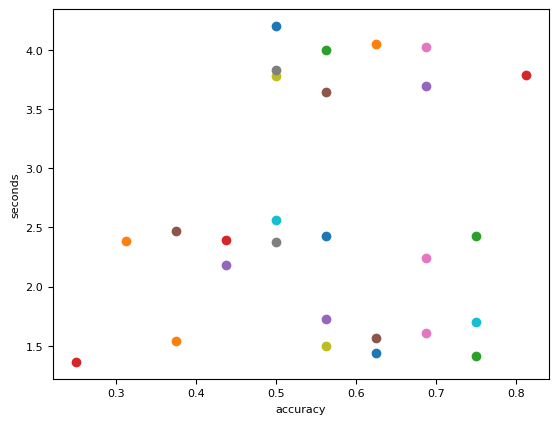

In [195]:
plt.figure()
acc = []
time = []
for res in params_results.values():
    plt.scatter(np.mean([ res[i][1]     for i in range(4)]), np.mean(np.mean([ res[i][2]     for i in range(4)])))

    
#plt.legend(params_results.keys())
plt.xlabel("accuracy")
plt.ylabel('seconds')

Text(0.5, 0, 'seconds')

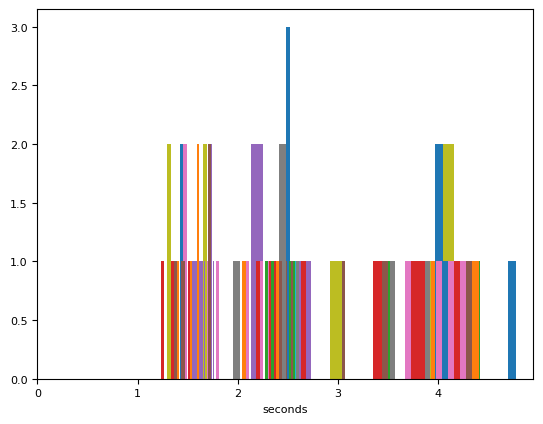

In [183]:
plt.figure()
for res in params_results.values():
    plt.hist( [ res[i][2]     for i in range(4)])
    

#plt.legend(params_results.keys())
plt.xlim([0, None])
plt.xlabel("seconds")

# Experiment 3

In [169]:
Lambda_qubo = 50
sym_anneal_num_anneals = 500   ### how many anneals in sym annealing

In [170]:
set_up_data(3)             ### keep three data as input
input_size = sum(select)
hidden_n = 3              ### num hidden layers
num_classes = 2            ### binary 
n_layers = 2               ### num layers

# create the pytorch NN
neural_network = BinaryNet()
print(neural_network)

BinaryNet(
  (fc_list): ModuleList(
    (0): BinaryLinear(in_features=3, out_features=3, bias=False)
    (1): BinaryLinear(in_features=3, out_features=1, bias=False)
  )
  (dropout): Dropout(p=0.2, inplace=False)
  (activation): BinaryTanh(
    (hardtanh): Hardtanh(min_val=-1.0, max_val=1.0)
  )
)


In [ ]:
num_vars = [8, 30, 50, 75, 100, 124, 167, 200, 256, 303, 374, 421, 780, 998, 1232, 1430, 1610, 1834, 2000, 2567, 3102, 3750, 4101]
grb_hard_results = {}

for i in num_vars:
    optimization_type = 'grb_hard_c'
    name = f'GRB HARD C {i}'
    print(f"Training model vars: {i}   batch size: {1}")
    result = train_models(neural_network, optimization_type, 1, 
                        i, Lambda_qubo, hidden_n, sym_anneal_num_anneals, x_test_data_reduced, y_test, verbose=False)
    grb_hard_results[name] = result

    with open('results_'+name+'.pkl', 'wb') as handle:
        pickle.dump(result, handle )

In [115]:
num_vars = [8, 30, 50, 75, 100, 124, 167, 200, 256, 303, 374, 421, 780, 998, 1232, 1430, 1610, 1834, 2000, 2567, 3102, 3750, 4101]
grb_hard_results = {}

for i in num_vars:
    optimization_type = 'grb_hard_c'
    name = f'GRB HARD C {i}'
    
    grb_hard_results[name] = load_result(name, dir="./results/variable_sizes/")

In [126]:
estimated_runtime = solver.estimate_qpu_access_time(num_vars, num_reads=500)

In [134]:
solver.num_active_qubits

5612

[]

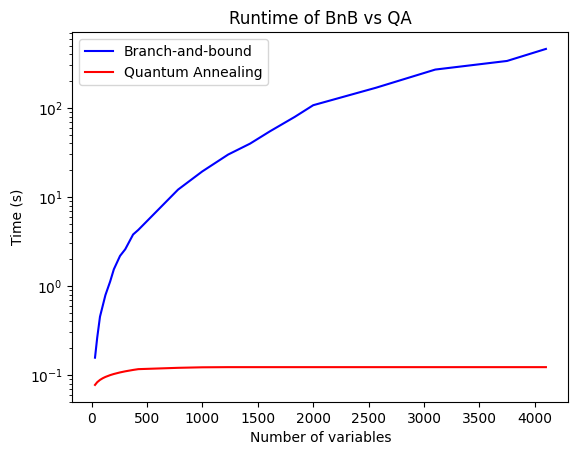

In [146]:
plt.figure()
num_vars = [30, 50, 75, 100, 124, 167, 200, 256, 303, 374, 421, 780, 998, 1232, 1430, 1610, 1834, 2000, 2567, 3102, 3750, 4101]
points_grb = []

for (name, res) in grb_hard_results.items():
    if (int(name.split(" ")[-1]) not in num_vars):
        continue

    p = [ res[i][2]     for i in range(len(res))]
    if p:
        points_grb.append(min(p))

plt.plot(num_vars, points_grb, c='blue')


estimated_runtime = solver.estimate_qpu_access_time(num_vars, num_reads=500)*0.000001
plt.plot(num_vars, estimated_runtime, c='red')


plt.title("Runtime of BnB vs QA")
plt.legend(["Branch-and-bound", "Quantum Annealing"])
plt.ylabel('Time (s)')
plt.xlabel('Number of variables')
plt.yscale('log')
plt.plot()

[]

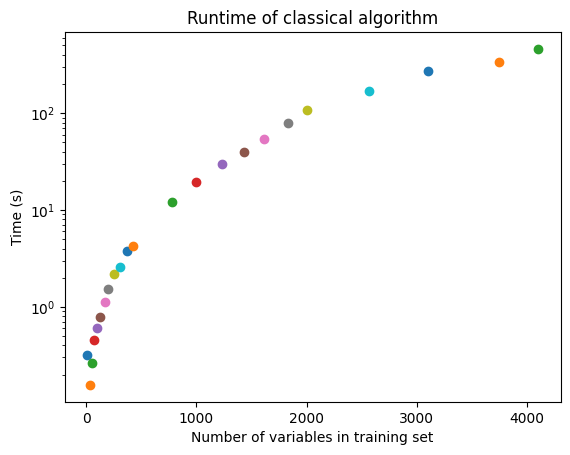

In [168]:
plt.figure()
for (name, res) in grb_hard_results.items():
    batch_size = int(name.split(" ")[-1])
    points = [ res[i][2]     for i in range(len(res))]
    
    if points:
        plt.scatter( batch_size, max(points))

plt.title("Runtime of classical algorithm")
plt.ylabel('Time (s)')
plt.xlabel('Number of variables in training set')
plt.yscale('log')
plt.plot()

# Experiment - Inspector

In [153]:
n_reads_qpu = 500
Lambda_qubo = 50
optimization_type = 'quantum_anneal_soft_embedded_qubo'

num_vars = 4
response, target_bqm, bqm, emb = train_models(neural_network, optimization_type, 1,
                    num_vars, Lambda_qubo, hidden_n, sym_anneal_num_anneals, x_data_reduced, y, verbose=False, n_reads_qpu=n_reads_qpu)

Num variables usadas para qubo en dwave solver 168


In [168]:
inspector.show_bqm_response(bqm, embedding_context={'embedding': emb}, response=response)

Serving Inspector on http://127.0.0.1:18000/?problemId=ba7f5b33-2cd1-45bb-ac42-750f3f562dcb

'http://127.0.0.1:18000/?problemId=ba7f5b33-2cd1-45bb-ac42-750f3f562dcb'

In [169]:
n_reads_qpu = 500
Lambda_qubo = 50
optimization_type = 'quantum_anneal_soft_embedded_qubo'

num_vars = 25
response, target_bqm, bqm, emb = train_models(neural_network, optimization_type, 1,
                    num_vars, Lambda_qubo, hidden_n, sym_anneal_num_anneals, x_data_reduced, y, verbose=False, n_reads_qpu=n_reads_qpu)

Num variables usadas para qubo en dwave solver 1345


In [170]:
inspector.show_bqm_response(bqm, embedding_context={'embedding': emb}, response=response)

Serving Inspector on http://127.0.0.1:18000/?problemId=e7021220-802d-4cd4-a552-e9d94b3372e6

'http://127.0.0.1:18000/?problemId=e7021220-802d-4cd4-a552-e9d94b3372e6'